In [1]:
import xarray as xr
import pandas as pd
import numpy as np
import scipy.sparse.linalg
import matplotlib.pyplot as plt
import matplotlib.colors
import proplot as pplt # New plot library (https://proplot.readthedocs.io/en/latest/)
pplt.rc['savefig.dpi'] = 300 # 1200 is too big! #https://proplot.readthedocs.io/en/latest/basics.html#Creating-figures

from numba import njit,prange
from numba.typed import List

In [2]:
full_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':False, 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[41.,50.],'lonlim':[0.,20.]}
# full_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':False, 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[42.,49.],'lonlim':[2.,18.]}
normal_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':True, 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}
multiplot_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':False, 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}
EUROCORDEX_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':False, 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[42.5,49],'lonlim':[2.5,16.5]}

# imin = 42 ; imax = -40
# jmin = 25 ; jmax = -25

# imin = 32 ; imax = -30
# jmin = 20 ; jmax = -15

imin = 15 ; imax = -23
jmin = 10 ; jmax = -6
# ds = xr.open_dataset('/bettik/beaumetj/MARout/MAR-ERA-20C/MARgrid_EUf.nc')
ds = xr.open_dataset('/bettik/beaumetj/MARout/MAR-ERA5/MARgrid_EUl.nc')
lon = ds.LON.data
lat = ds.LAT.data
H = ds.SH.data

lon_ = ds.LON.data[jmin:jmax,imin:imax]
lat_ = ds.LAT.data[jmin:jmax,imin:imax]
H_ = ds.SH.data[jmin:jmax,imin:imax]

(<matplotlib.lines.Line2D at 0x7f08ec54fdc0>,)

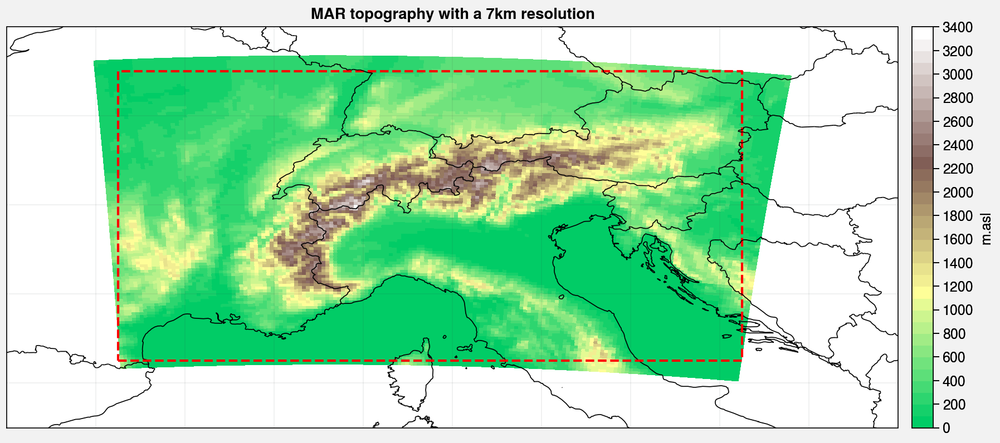

In [3]:
colors_land = plt.cm.terrain(np.linspace(0.25, 1, 256))
f, ax = pplt.subplots(proj='cyl', axwidth=8)
m=ax.pcolormesh(lon_, lat_, H_, levels=34,cmap=colors_land)
# m=ax.pcolormesh(lon, lat, H, levels=34,cmap=colors_land)
# cp = ax.contour(lon_, lat_, H_, levels=np.array([500]),color='k',linewidth=0.5)
# ax.clabel(cp, inline=True, fontsize=5)
f.colorbar(m,label= 'm.asl')
ax.format(**full_format,suptitle='MAR topography with a 7km resolution')
# ax.format(ocean=False,oceancolor='royalblue',reso='hi', latlim=[40.,51.],lonlim=[0.,20.])
# ax.plot([4.,16.,16,4,4],[43.,43,48.5,48.5,43],'--r')
ax.plot([2.5,16.5,16.5,2.5,2.5],[42.5,42.5,49,49,42.5],'--r')

In [64]:
ds_rr = xr.open_mfdataset('/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.MBrr.*.nc')
ds_sf = xr.open_mfdataset('/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.MBsf.*.nc')
# ds_pr = xr.open_dataset('/bettik/philinat/EURO4M_APGD/APGD_'+str(year)+'.nc')
dates = ds_rr.MBrr.time
prec = np.array(ds_rr.MBrr.data[:,jmin:jmax,imin:imax] + ds_sf.MBsf.data[:,jmin:jmax,imin:imax])
print(np.shape(prec))

(14976, 110, 163)


In [8]:
selection = np.nanmax(prec,axis=(1,2))>50
events = prec[selection,:,:]
event_dates = dates[selection]
event_months = event_dates.dt.month
event_maxs = np.nanmax(events,axis=(1,2))
print(np.shape(events))

(4554, 110, 163)


In [62]:
Tmin = np.array(xr.open_mfdataset('/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.TTmin.*.nc').TTmin.data[selection,0,jmin:jmax,imin:imax])
# Tmean = np.array(xr.open_mfdataset('/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.TTz.*.nc').TTz.data[selection,0,jmin:jmax,imin:imax])
SP = np.array(xr.open_mfdataset('/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.SP.*.nc').SP.data[selection,jmin:jmax,imin:imax])
SLP = SP * (1-  0.0065*H_/ (Tmin+273.15+0.0065*H_))**(-5.257)

In [63]:
U = np.array(xr.open_mfdataset('/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.UUz.*.nc').UUz.data[selection,3,jmin:jmax,imin:imax])
V = np.array(xr.open_mfdataset('/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.VVz.*.nc').VVz.data[selection,3,jmin:jmax,imin:imax])

In [56]:
print(np.shape(U),np.shape(V),np.shape(SLP))

(878, 110, 163) (878, 110, 163) (878, 110, 163)


In [66]:
data_events = np.array([events,SLP,U,V])
np.save('/home/philinat/Stage-M2/saved_data_MAR_ERA5/data_events.npy',data_events)
np.save('/home/philinat/Stage-M2/saved_data_MAR_ERA5/event_months.npy',event_months)

In [3]:
events,SLP,U,V = np.load('/home/philinat/Stage-M2/saved_data_MAR_ERA5/data_events.npy')
event_months = np.load('/home/philinat/Stage-M2/saved_data_MAR_ERA5/event_months.npy')
event_maxs = np.nanmax(events,axis=(1,2))

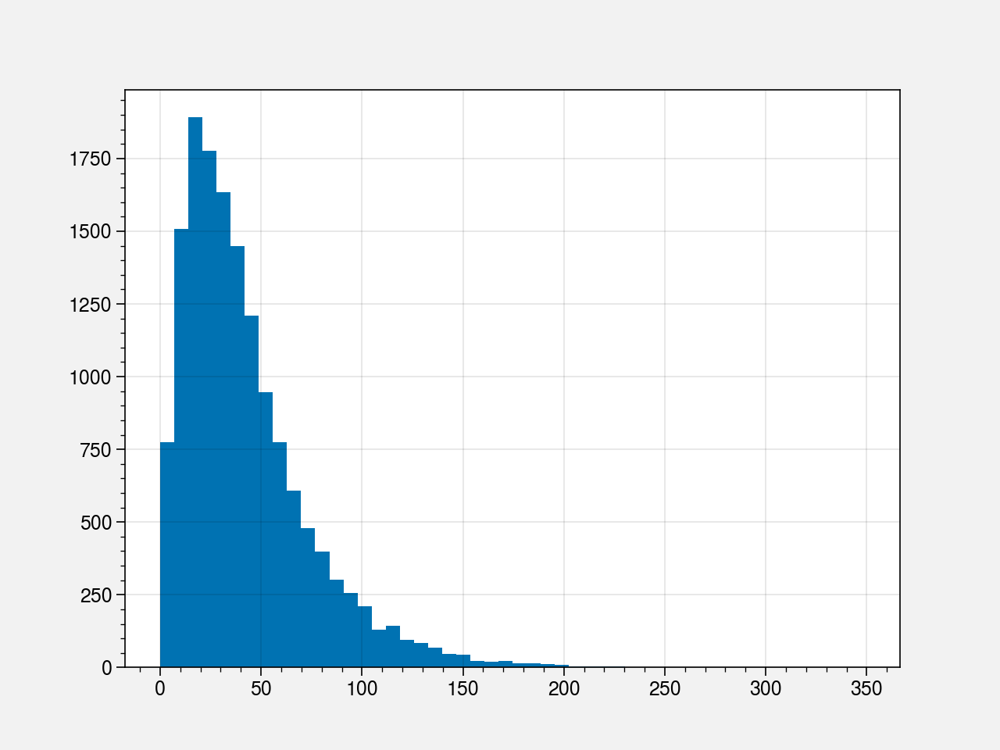

In [7]:
plt.hist(np.nanmax(prec,axis=(1,2)),bins=50)
plt.show()

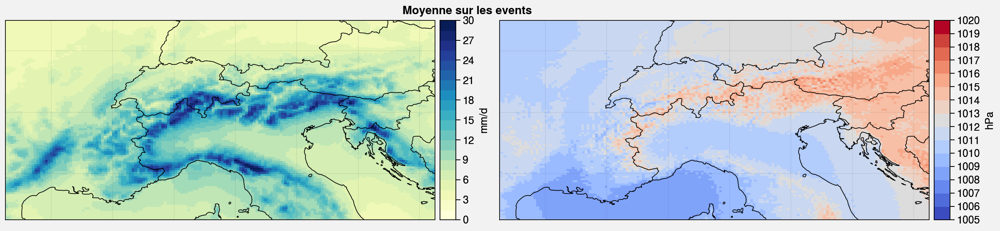

In [4]:
f, axs = pplt.subplots(proj='cyl',ncols=2, nrows=1,width=12)
cb_prec=axs[0].pcolormesh(lon_,lat_,np.mean(events,axis=0),levels=np.linspace(0,30,21),cmap='YlGnBu')
f.colorbar(cb_prec,ax=axs[0],label= 'mm/d')
cb_SLP=axs[1].pcolormesh(lon_,lat_,np.mean(SLP,axis=0),levels=np.linspace(1005,1020,16),cmap='coolwarm')
f.colorbar(cb_SLP,ax=axs[1],label= 'hPa')
axs.format(**EUROCORDEX_format,suptitle='Moyenne sur les events')

In [5]:
@njit(parallel=True)
def get_distances(events):
    ne,nlat,lon = np.shape(events)
    distances = np.zeros((ne,ne))
    for i in range(ne):
        for j in prange(ne):
            if j<i:
                distances[i,j] = distances[j,i]
            elif j>i:
                x=events[i]#-np.nanmean(events[i])
                y=events[j]#-np.nanmean(events[j])
                distances[i,j] = 1- np.nansum(x*y) / np.sqrt(np.nansum(x**2)*np.nansum(y**2))
            elif j==i:
                distances[i,j]=1.
    return distances

# @njit(parallel=True)
# def get_distances_SLP(events,SLP):
#     ne,nlat,lon = np.shape(events)
#     distances = np.zeros((ne,ne))
#     for i in range(ne):
#         for j in prange(ne):
#             if j<i:
#                 distances[i,j] = distances[j,i]
#             elif j>i:
#                 x=events[i]#-np.mean(events[i])
#                 y=events[j]#-np.mean(events[j])
#                 distances[i,j] += 1- np.sum(x*y) / np.sqrt(np.sum(x**2)*np.sum(y**2))
#                 x=SLP[i]-np.mean(SLP[i])
#                 y=SLP[j]-np.mean(SLP[j])
#                 distances[i,j] += 1- np.sum(x*y) / np.sqrt(np.sum(x**2)*np.sum(y**2))
#             elif j==i:
#                 distances[i,j]=3.
#     return distances

@njit(parallel=True)
def get_distances_UV(events,U,V):
    ne,nlat,lon = np.shape(events)
    distances = np.ones((ne,ne))
    for i in range(ne):
        for j in prange(ne):
            if j<i:
                distances[i,j] = distances[j,i]
            elif j>i:
                x=events[i]
                y=events[j]
                distances[i,j] *= 1- np.sum(x*y) / np.sqrt(np.sum(x**2)*np.sum(y**2))
                # distances[i,j] *= (1- np.sum(U[i]*U[j]+V[i]*V[j]) / np.sqrt(np.sum(U[i]**2+V[i]**2)*np.sum(U[j]**2+V[j]**2)))/2
                distances[i,j] = distances[i,j]/2 + (1- np.sum(U[i]*U[j]+V[i]*V[j]) / np.sqrt(np.sum(U[i]**2+V[i]**2)*np.sum(U[j]**2+V[j]**2)))/4
            
    return distances

In [6]:
# distances = get_distances(events)
# distances = get_distances_SLP(events,SLP)
distances = get_distances_UV(events,U,V)

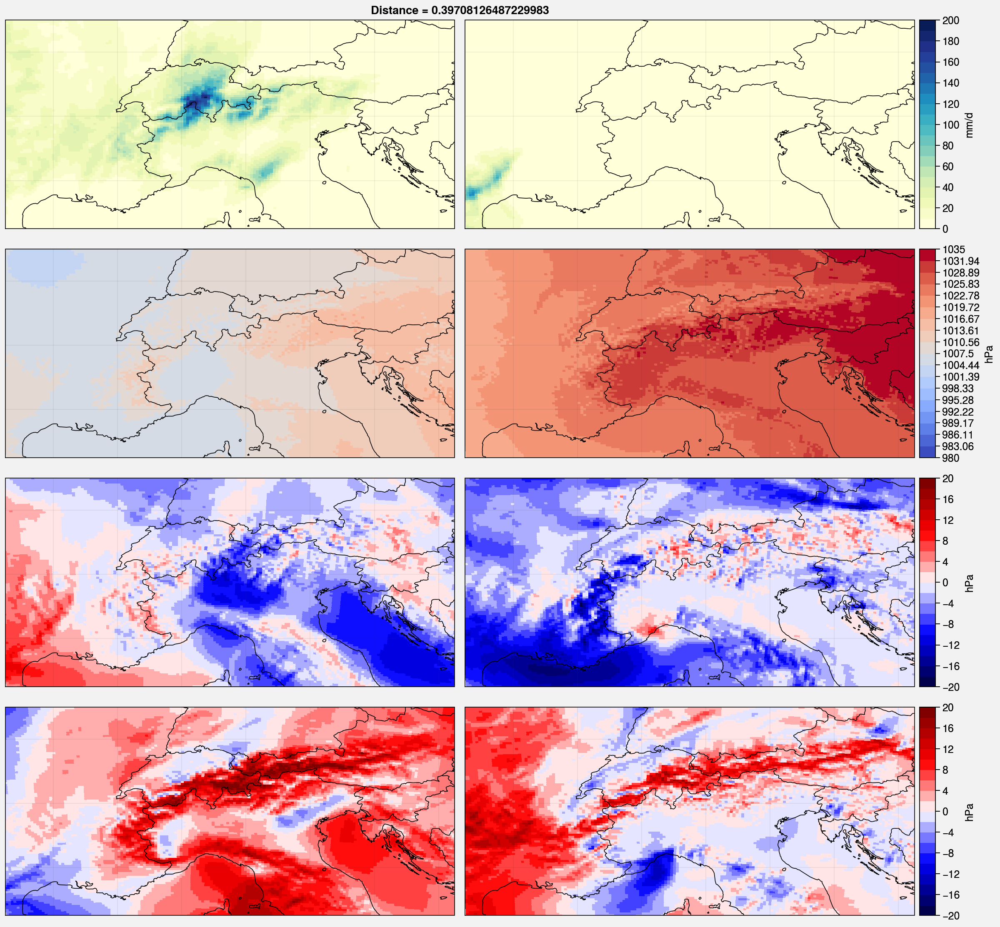

In [62]:
i,j = np.random.randint(0,len(events)-1,2)
f, axs = pplt.subplots(proj='cyl',ncols=2, nrows=4,width=12)
axs[0].pcolormesh(lon_,lat_,events[i],levels=np.linspace(0,200,21),cmap='YlGnBu')
cb_prec = axs[1].pcolormesh(lon_,lat_,events[j],levels=np.linspace(0,200,21),cmap='YlGnBu')
f.colorbar(cb_prec,ax=axs[1],label= 'mm/d')
axs[2].pcolormesh(lon_,lat_,SLP[i],levels=np.linspace(980,1035,19),cmap='coolwarm')
cb_SLP = axs[3].pcolormesh(lon_,lat_,SLP[j],levels=np.linspace(980,1035,19),cmap='coolwarm')
f.colorbar(cb_SLP,ax=axs[3],label= 'hPa')

axs[4].pcolormesh(lon_,lat_,U[i],levels=np.linspace(-20,20,21),cmap='seismic')
cb_SLP = axs[5].pcolormesh(lon_,lat_,U[j],levels=np.linspace(-20,20,21),cmap='seismic')
f.colorbar(cb_SLP,ax=axs[5],label= 'hPa')

axs[6].pcolormesh(lon_,lat_,V[i],levels=np.linspace(-20,20,21),cmap='seismic')
cb_SLP = axs[7].pcolormesh(lon_,lat_,V[j],levels=np.linspace(-20,20,21),cmap='seismic')
f.colorbar(cb_SLP,ax=axs[7],label= 'hPa')

axs.format(**EUROCORDEX_format,suptitle='Distance = '+str(distances[i,j]))

In [33]:
# @njit()
def cluster_dist_matrix(clusters,distances):
    nc = len(clusters)
    cluster_dist = np.zeros((nc,nc))
    for i in range(nc):
        for j in range(nc):
            if j<i:
                cluster_dist[i,j] = cluster_dist[j,i]
            elif j>i:
                mean_dist = 0.
                for k in range(len(clusters[i])):
                    for l in range(len(clusters[j])):
                        mean_dist += distances[clusters[i][k],clusters[j][l]]
                cluster_dist[i,j] = mean_dist/len(clusters[i])/len(clusters[j])
                # cluster_dist[i,j] = np.mean([np.mean(distances[c,clusters[j]]) for c in clusters[i]])
    return cluster_dist

def make_typed_clusters(clusters):
    clusters_ = List()
    for c in clusters:
        c_ = List()
        for i in c:
            c_.append(i)
        clusters_.append(c_)
    return clusters_

In [7]:
def get_clusters(distances,threshold):
    ne,_ = np.shape(distances)
    cluster_dist = np.copy(distances)
    clusters = [ [i] for i in range(ne)]
    
    for i in range(ne-1):
        if i%10==0: print(i,end=' ')
        min_dist = np.min(cluster_dist)
        k,l = np.where( cluster_dist==min_dist )[0][:2]
        if k>l: k,l=l,k
        nk = len(clusters[k]) ; nl = len(clusters[l])
        clusters[k] += clusters.pop(l)
        cluster_dist[k,:] = (nk*cluster_dist[k,:] + nl*cluster_dist[l,:])/(nk+nl)
        cluster_dist[:,k] = (nk*cluster_dist[:,k] + nl*cluster_dist[:,l])/(nk+nl)
        cluster_dist[k,k] = 1.
        cluster_dist = np.delete(cluster_dist,l,axis=0) ; cluster_dist = np.delete(cluster_dist,l,axis=1)
        
    sorted_events = clusters[0]
    cluster_dist = distances[:,sorted_events][sorted_events,:]
    clusters = [ [i] for i in sorted_events]
    coords = [ np.array([i+1.,0.]) for i in range(ne)]
    lines = np.zeros((ne-1,2,4))
    
    got_saved_clusters = False
    for i in range(ne-1):
        if i%10==0: print(i,end=' ')
        min_dist = np.min(cluster_dist)
        k,l = np.where( cluster_dist==min_dist )[0][:2]
        if k>l: k,l=l,k
        if min_dist>threshold and not(got_saved_clusters):
            saved_clusters = [c.copy() for c in clusters]
            got_saved_clusters = True
            
        nk = len(clusters[k]) ; nl = len(clusters[l])
        clusters[k] += clusters.pop(l)
        lines[i] = np.array([[coords[k][0],coords[k][0],coords[l][0],coords[l][0]],[coords[k][1],min_dist,min_dist,coords[l][1]]])
        coords[k] = np.array([ (coords[k][0]+coords[l][0])/2 , min_dist]) ; coords.pop(l)
        cluster_dist[k,:] = (nk*cluster_dist[k,:] + nl*cluster_dist[l,:])/(nk+nl)
        cluster_dist[:,k] = (nk*cluster_dist[:,k] + nl*cluster_dist[:,l])/(nk+nl)
        cluster_dist[k,k] = 1.
        cluster_dist = np.delete(cluster_dist,l,axis=0) ; cluster_dist = np.delete(cluster_dist,l,axis=1)
    return saved_clusters,lines,sorted_events

In [ ]:
# @njit
def get_clusters(distances,threshold):
    # distances = get_distances(events)
    # distances = get_distances_SLP(events,SLP)
    ne,_ = np.shape(distances)
    
    cluster_dist = np.copy(distances)
    clusters = List()
    for i in range(ne):
        c = List()
        c.append(i)
        clusters.append(c)

    for i in range(ne-1):
        # if i%10==0: print(i,end=' ')
        print(np.shape(cluster_dist))
        # min_dist = np.min(cluster_dist)
        # min_dist = cluster_dist.min()
        min_dist = 1. ; min_k=0 ; min_l=0
        for kk in range(ne-i):
            for ll in range(kk+1,ne-i):
                if cluster_dist[kk,ll] < min_dist:
                    min_dist = cluster_dist[kk,ll]
                    k,l = kk,ll
        # k,l = np.where( cluster_dist==min_dist )[0][:2]
        # if k>l: k,l=l,k
        nk = len(clusters[k]) ; nl = len(clusters[l])
        # clusters[k] += clusters.pop(l)
        clusters[k].extend(clusters[l]) ; clusters.pop(l)
        cluster_dist[k,:] = (nk*cluster_dist[k,:] + nl*cluster_dist[l,:])/(nk+nl)
        cluster_dist[:,k] = (nk*cluster_dist[:,k] + nl*cluster_dist[:,l])/(nk+nl)
        cluster_dist[k,k] = 1.
        # cluster_dist = np.delete(cluster_dist,l,axis=0) ; cluster_dist = np.delete(cluster_dist,l,axis=1)
        print(np.shape(cluster_dist))
        cluster_dist = np.delete(cluster_dist,l)
        print(np.shape(cluster_dist)); cluster_dist = np.transpose(np.delete(np.transpose(cluster_dist),l))
        print(np.shape(cluster_dist))
    sorted_events = clusters[0]
    # return sorted_events
    cluster_dist = distances[:,sorted_events][sorted_events,:]
    clusters = List()
    for i in sorted_events:
        c = List()
        c.append(i)
        clusters.append(c)
    coords = List()
    for i in range(ne):
        coords.append(np.array([i+1.,0.]))
    
    lines = np.zeros((ne-1,2,4))
    
    got_saved_clusters = False
    for i in range(ne-1):
        # if i%10==0: print(i,end=' '):
        min_dist = 1. ; min_k=0 ; min_l=0
        for kk in range(ne-i):
            for ll in range(kk+1,ne-i):
                if cluster_dist[kk,ll] < min_dist:
                    min_dist = cluster_dist[kk,ll]
                    k,l = kk,ll
                    
        # min_dist = np.min(cluster_dist)
        # k,l = np.where( cluster_dist==min_dist )[0][:2]
        # if k>l: k,l=l,k
        
        if min_dist>threshold and not(got_saved_clusters):
            saved_clusters = List()
            for c in clusters:
                saved_clusters.append(c.copy())
            got_saved_clusters = True
            
        
        nk = len(clusters[k]) ; nl = len(clusters[l])
        # clusters[k] += clusters.pop(l)
        clusters[k].extend(clusters[l]) ; clusters.pop(l)
        lines[i] = np.array([[coords[k][0],coords[k][0],coords[l][0],coords[l][0]],[coords[k][1],min_dist,min_dist,coords[l][1]]])
        coords[k] = np.array([ (coords[k][0]+coords[l][0])/2 , min_dist]) ; coords.pop(l)
        cluster_dist[k,:] = (nk*cluster_dist[k,:] + nl*cluster_dist[l,:])/(nk+nl)
        cluster_dist[:,k] = (nk*cluster_dist[:,k] + nl*cluster_dist[:,l])/(nk+nl)
        cluster_dist[k,k] = 1.
        # cluster_dist = np.delete(cluster_dist,l,axis=0) ; cluster_dist = np.delete(cluster_dist,l,axis=1)
        cluster_dist = np.delete(cluster_dist,l) ; cluster_dist = np.transpose(np.delete(np.transpose(cluster_dist),l))
    return saved_clusters,lines

0 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 520 530 540 550 560 570 580 590 600 610 620 630 640 650 660 670 680 690 700 710 720 730 740 750 760 770 780 790 800 810 820 830 840 850 860 870 0 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 520 530 540 550 560 570 580 590 600 610 620 630 640 650 660 670 680 690 700 710 720 730 740 750 760 770 780 790 800 810 820 830 840 850 860 870 

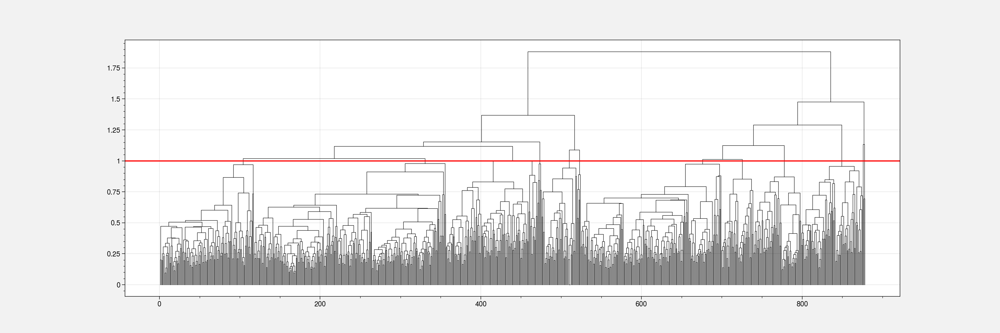

In [8]:
threshold = 1.
clusters,lines,sorted_events = get_clusters(distances,threshold)
plt.figure(figsize=(18,6))
for i in range(len(lines)):
    plt.plot(lines[i,0,:],lines[i,1,:],color='k',linewidth=0.5)
plt.axhline(threshold, color='r', linestyle='-')
plt.show()

0 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 520 530 540 550 560 570 580 590 600 610 620 630 640 650 660 670 680 690 700 710 720 730 740 750 760 770 780 790 800 810 820 830 840 850 860 870 0 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 520 530 540 550 560 570 580 590 600 610 620 630 640 650 660 670 680 690 700 710 720 730 740 750 760 770 780 790 800 810 820 830 840 850 860 870 

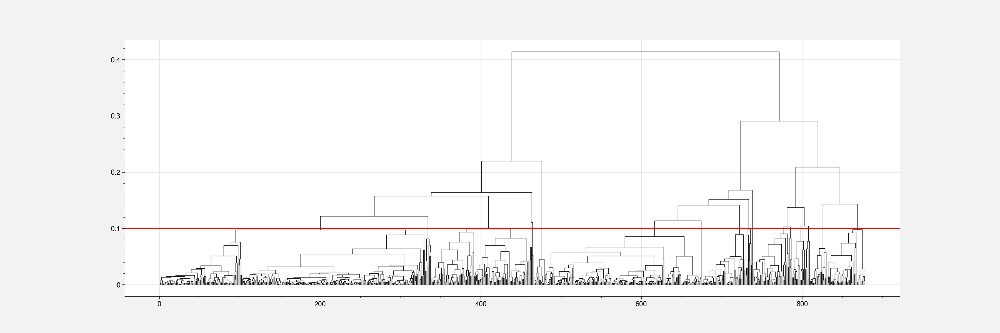

In [41]:
threshold = 0.1
clusters,lines,sorted_events = get_clusters(distances,threshold)
plt.figure(figsize=(18,6))
for i in range(len(lines)):
    plt.plot(lines[i,0,:],lines[i,1,:],color='k',linewidth=0.5)
plt.axhline(threshold, color='r', linestyle='-')
plt.show()

0 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 520 530 540 550 560 570 580 590 600 610 620 630 640 650 660 670 680 690 700 710 720 730 740 750 760 770 780 790 800 810 820 830 840 850 860 870 0 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 520 530 540 550 560 570 580 590 600 610 620 630 640 650 660 670 680 690 700 710 720 730 740 750 760 770 780 790 800 810 820 830 840 850 860 870 

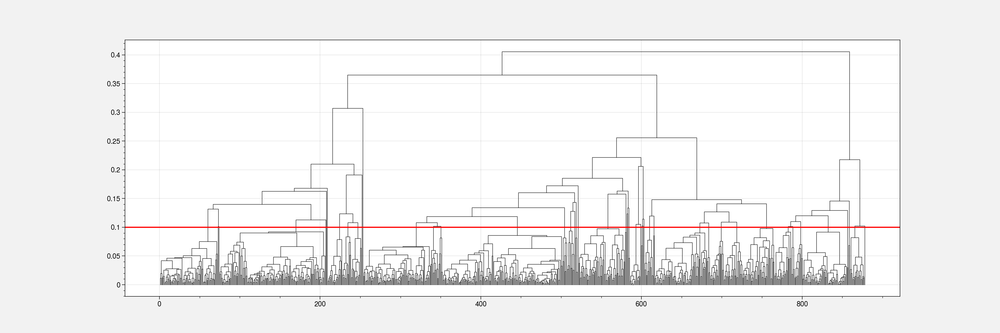

In [7]:
threshold = 0.1
clusters,lines,sorted_events = get_clusters(distances,threshold)
plt.figure(figsize=(18,6))
for i in range(len(lines)):
    plt.plot(lines[i,0,:],lines[i,1,:],color='k',linewidth=0.5)
plt.axhline(threshold, color='r', linestyle='-')
plt.show()

0 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 520 530 540 550 560 570 580 590 600 610 620 630 640 650 660 670 680 690 700 710 720 730 740 750 760 770 780 790 800 810 820 830 840 850 860 870 0 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 520 530 540 550 560 570 580 590 600 610 620 630 640 650 660 670 680 690 700 710 720 730 740 750 760 770 780 790 800 810 820 830 840 850 860 870 

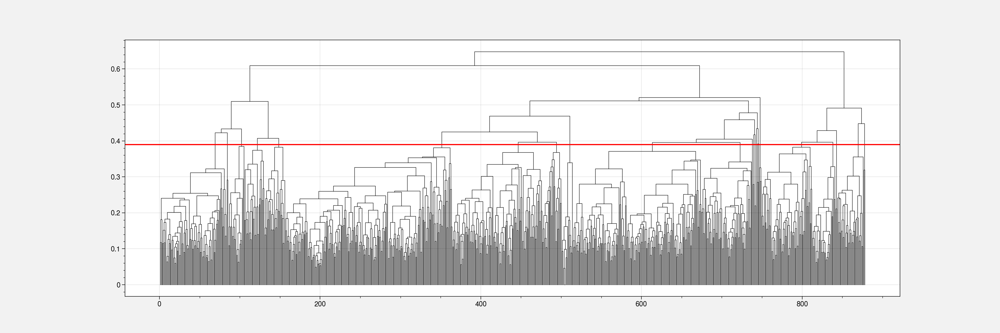

In [8]:
threshold = 0.39
clusters,lines,sorted_events = get_clusters(distances,threshold)
plt.figure(figsize=(18,6))
for i in range(len(lines)):
    plt.plot(lines[i,0,:],lines[i,1,:],color='k',linewidth=0.5)
plt.axhline(threshold, color='r', linestyle='-')
plt.show()

0 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 520 530 540 550 560 570 580 590 600 610 620 630 640 650 660 670 680 690 700 710 720 730 740 750 760 770 780 790 800 810 820 830 840 850 860 870 0 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 520 530 540 550 560 570 580 590 600 610 620 630 640 650 660 670 680 690 700 710 720 730 740 750 760 770 780 790 800 810 820 830 840 850 860 870 

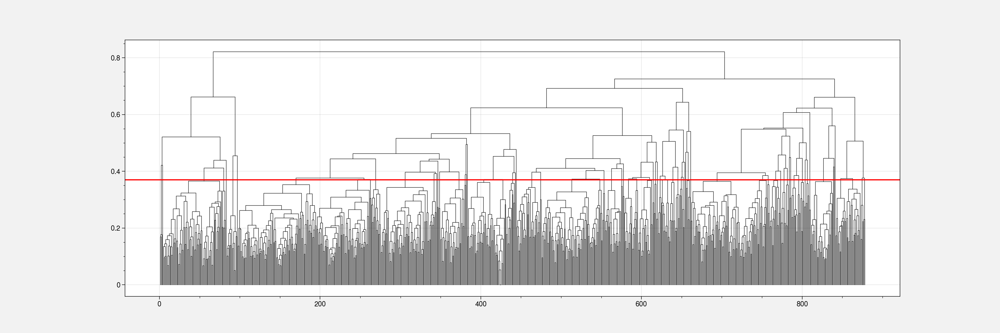

In [48]:
threshold = 0.37
clusters,lines,sorted_events = get_clusters(distances,threshold)
plt.figure(figsize=(18,6))
for i in range(len(lines)):
    plt.plot(lines[i,0,:],lines[i,1,:],color='k',linewidth=0.5)
plt.axhline(threshold, color='r', linestyle='-')
plt.show()

In [13]:
print([len(c) for c in clusters])
print(len(events),sum([len(c) for c in clusters]))

[83, 2, 20, 25, 26, 208, 112, 24, 14, 160, 63, 1, 2, 2, 1, 2, 1, 3, 63, 29, 2, 33, 2]
878 878


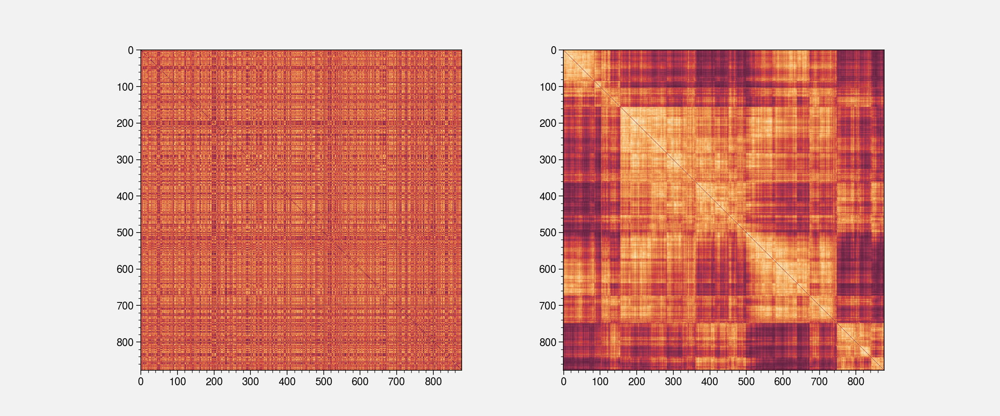

In [20]:
f,ax = plt.subplots(figsize=(12,5),ncols=2)
ax[0].imshow(distances)
ax[1].imshow(distances[:,sorted_events][sorted_events,:])

In [43]:
freq = np.array([len(c) for c in clusters])
sort = np.argsort(freq)[::-1]
freq = freq[sort]

centroids = np.array([np.mean(events[c],0) for c in clusters])[sort]
centroids_SLP = np.array([np.mean(SLP[c],0) for c in clusters])[sort]
centroids_U = np.array([np.mean(U[c],0) for c in clusters])[sort]
centroids_V = np.array([np.mean(V[c],0) for c in clusters])[sort]

In [41]:
centroids = []
for c in clusters:
    dist = get_distances_UV(events[c],U[c],V[c])
    k = np.argmin(np.mean(dist,0))
    centroids.append(events[c[k]])
centroids = np.array(centroids)[sort]

In [11]:
from scipy.ndimage import gaussian_filter
def show_clustering(ncols=4, nrows=5,title=''):
    f, axs = pplt.subplots(proj='cyl',ncols=ncols, nrows=nrows,width=12)
    for i in range(min(ncols*nrows,len(centroids))):
        cb_prec=axs[i].pcolormesh(lon_,lat_,centroids[i],levels=np.linspace(0,100,21),cmap='YlGnBu')
        axs[i].format(title=str(np.around(100*freq[i]/np.sum(freq),1))+' %',titlesize='20px')

        cb_SLP = axs[i].contour(lon_,lat_,gaussian_filter(centroids_SLP[i], 5),levels=np.linspace(990,1035,19),cmap='coolwarm')
        step=12
        axs[i].quiver(lon_[::step,::step],lat_[::step,::step],centroids_U[i,::step,::step],centroids_V[i,::step,::step],width=0.004,scale=250)

    f.colorbar(cb_SLP,label= 'hPa')
    f.colorbar(cb_prec,label= 'mm/d')
    axs.format(**EUROCORDEX_format,suptitle=title)

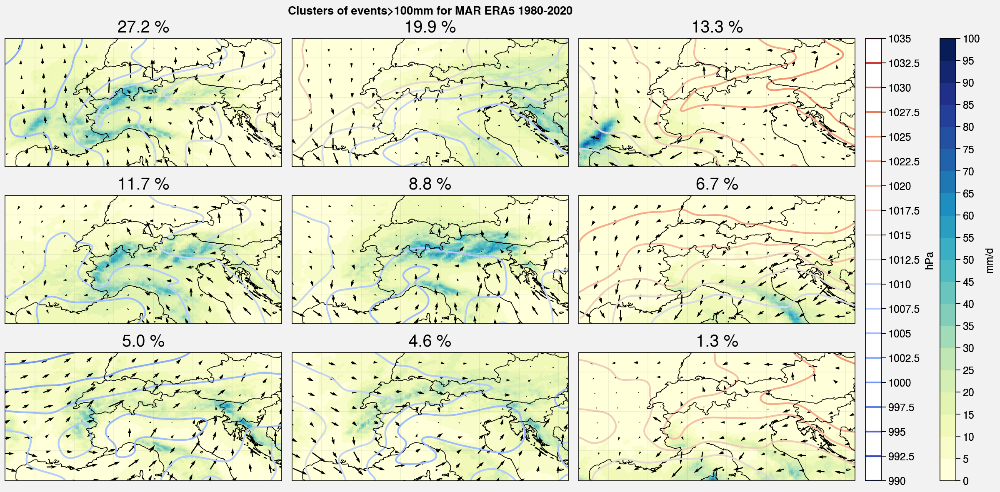

In [78]:
show_clustering(ncols=3, nrows=3,title='Clusters of events>100mm for MAR ERA5 1980-2020')

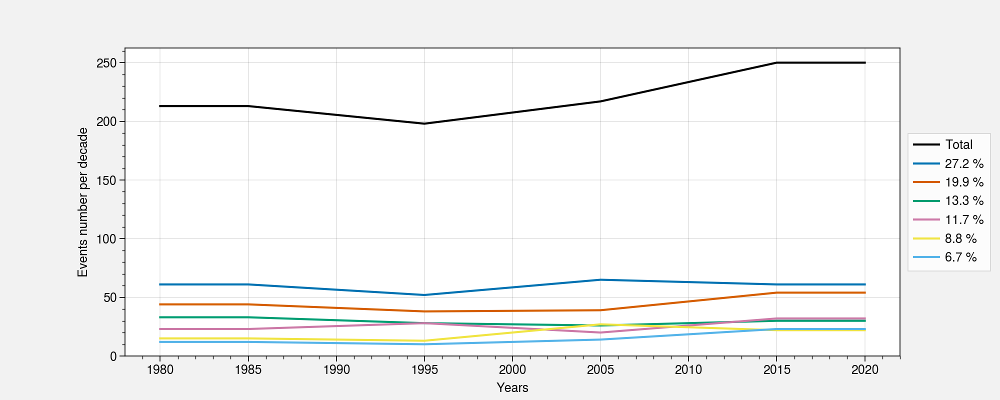

In [81]:
year = 1980
event_years = year*np.ones_like(event_months)
for i in range(1,len(event_months)):
    if event_months[i]<event_months[i-1]:
        year += 1
    event_years[i] = year

plt.figure(figsize=(10,4))
bins=np.arange(np.min(event_years),np.max(event_years)+1,10)
n_decade,_,_ = plt.hist(event_years,bins=bins,alpha=0,color='k')#,histtype='step',label=str(np.around(100*freq[i]/np.sum(freq),1))+' %' )
plt.plot(np.concatenate(([bins[0]],(bins[1:]+bins[:-1])/2,[bins[-1]])),np.concatenate(([n_decade[0]],n_decade,[n_decade[-1]])),color='k',label='Total')

for i,ci in enumerate(sort[:6]):
    c_years = event_years[clusters[ci]]
    n_decade,_,_ = plt.hist(c_years,bins=bins,alpha=0,color='k')#,histtype='step',label=str(np.around(100*freq[i]/np.sum(freq),1))+' %' )
    plt.plot(np.concatenate(([bins[0]],(bins[1:]+bins[:-1])/2,[bins[-1]])),np.concatenate(([n_decade[0]],n_decade,[n_decade[-1]])),label=str(np.around(100*freq[i]/np.sum(freq),1))+' %' )
plt.xlabel('Years')
plt.ylabel('Events number per decade')
plt.legend(loc='center left', bbox_to_anchor=(1.01, 0.5))

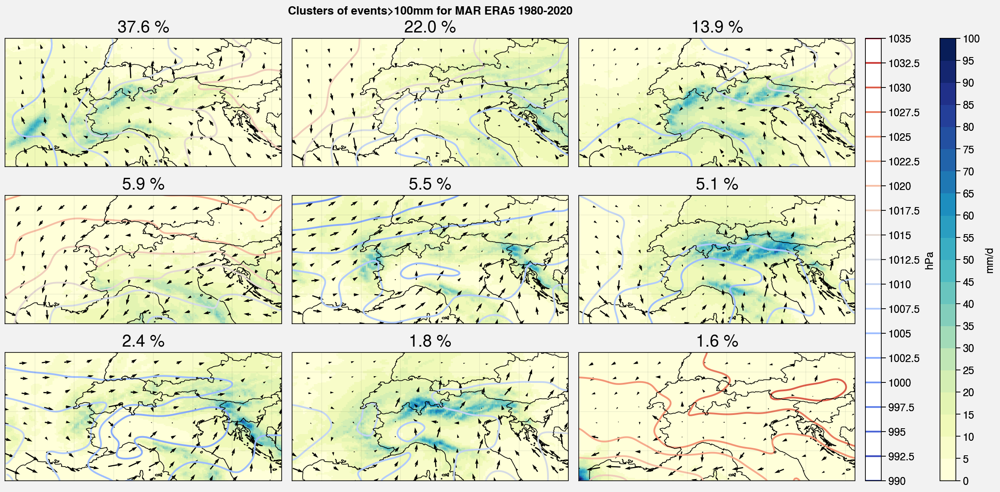

In [44]:
show_clustering(ncols=3, nrows=3,title='Clusters of events>100mm for MAR ERA5 1980-2020')

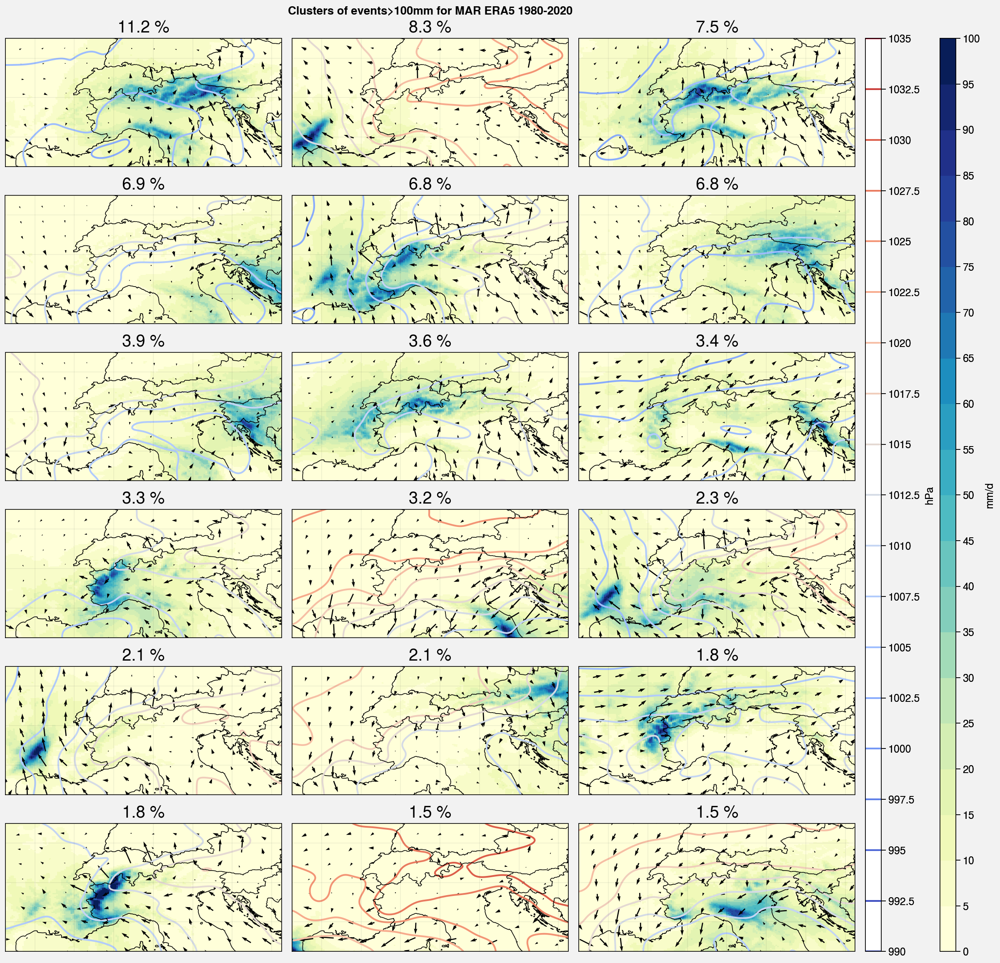

In [51]:
show_clustering(ncols=3, nrows=6,title='Clusters of events>100mm for MAR ERA5 1980-2020')

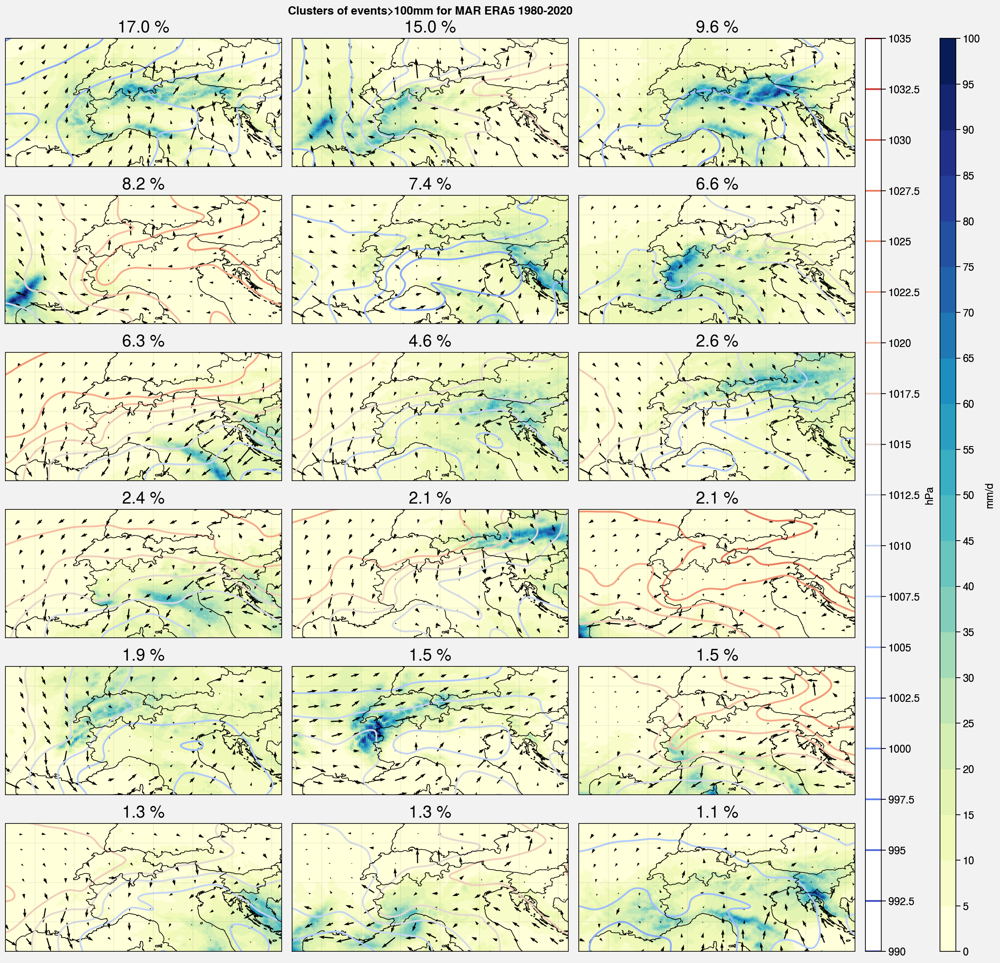

In [66]:
show_clustering(ncols=3, nrows=6,title='Clusters of events>100mm for MAR ERA5 1980-2020')

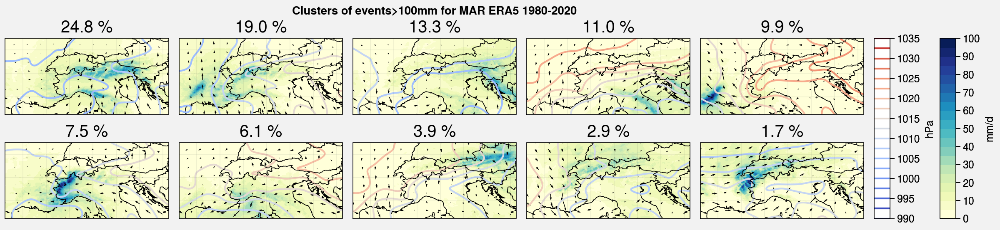

In [29]:
show_clustering(ncols=5, nrows=2,title='Clusters of events>100mm for MAR ERA5 1980-2020')

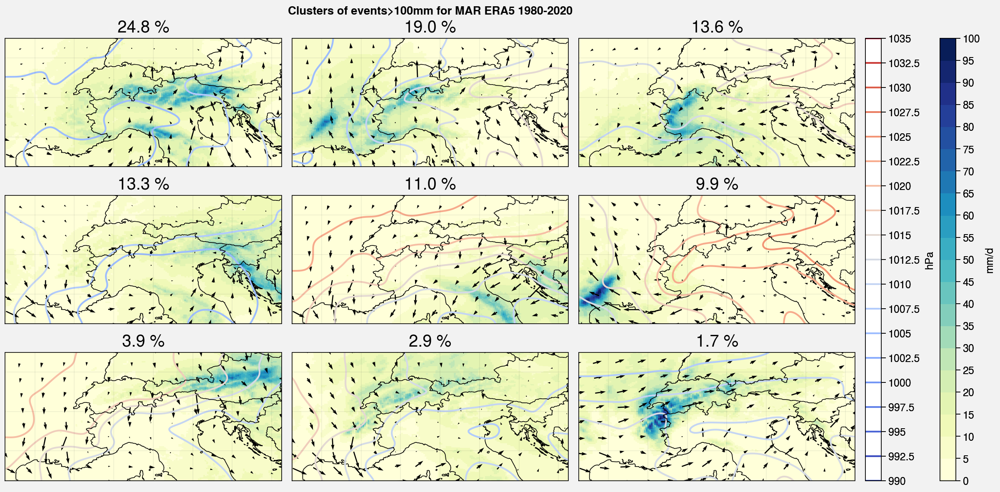

In [44]:
show_clustering(ncols=3, nrows=3,title='Clusters of events>100mm for MAR ERA5 1980-2020')

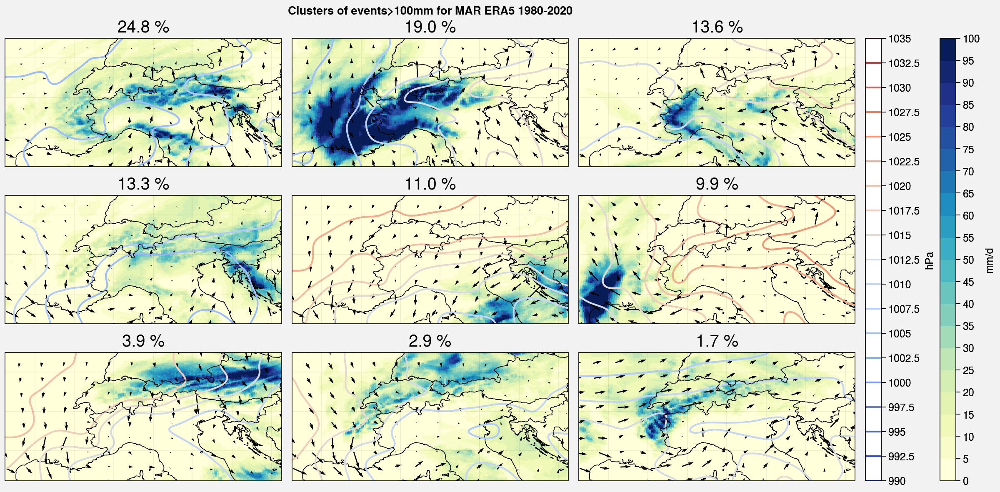

In [42]:
show_clustering(ncols=3, nrows=3,title='Clusters of events>100mm for MAR ERA5 1980-2020')

In [53]:
new_clusters = [clusters[sort[i]] for i in [8,7,6,5,2,4,1,0,3]]
print([len(c) for c in new_clusters])

[14, 24, 33, 83, 114, 92, 160, 208, 112]


In [51]:
print([len(c) for c in clusters])
print(len(events),sum([len(c) for c in clusters]))

[83, 114, 208, 112, 24, 14, 160, 92, 33]
878 840


In [16]:
for i in range(len(clusters)-1,-1,-1):
    if len(clusters[i])<10:
        clusters.pop(i)

In [24]:
clusters[9]+=clusters.pop(10)
clusters[1]+=clusters.pop(2)

In [35]:
dist = cluster_dist_matrix(clusters,distances)
print(dist)

[[0.         0.51280061 0.66620142 0.76622735 0.7994136  0.75157109
  0.46661685 0.54134379 0.73056347 0.81062361]
 [0.51280061 0.         0.55572187 0.60844409 0.64877244 0.75996354
  0.5471842  0.42572572 0.51231154 0.67640134]
 [0.66620142 0.55572187 0.         0.41365713 0.47780051 0.46015307
  0.43949142 0.43352505 0.62509039 0.64958687]
 [0.76622735 0.60844409 0.41365713 0.         0.39672551 0.49799759
  0.62935558 0.58028463 0.49133299 0.45966516]
 [0.7994136  0.64877244 0.47780051 0.39672551 0.         0.41591119
  0.64693222 0.60350079 0.54941388 0.44400389]
 [0.75157109 0.75996354 0.46015307 0.49799759 0.41591119 0.
  0.50999813 0.61139791 0.74714616 0.62556492]
 [0.46661685 0.5471842  0.43949142 0.62935558 0.64693222 0.50999813
  0.         0.39597669 0.75244729 0.79344682]
 [0.54134379 0.42572572 0.43352505 0.58028463 0.60350079 0.61139791
  0.39597669 0.         0.61541707 0.72365773]
 [0.73056347 0.51231154 0.62509039 0.49133299 0.54941388 0.74714616
  0.75244729 0.61541

In [37]:
clusters[1]+=clusters.pop(7)

In [60]:
centroids = np.array([np.mean(events[c],0) for c in new_clusters])
centroids_SLP = np.array([np.mean(SLP[c],0) for c in new_clusters])
centroids_U = np.array([np.mean(U[c],0) for c in new_clusters])
centroids_V = np.array([np.mean(V[c],0) for c in new_clusters])

In [61]:
centroids_data = np.array([centroids,centroids_SLP,centroids_U,centroids_V])

In [62]:
np.save('/home/philinat/Stage-M2/saved_clustering/centroids_data.npy',centroids_data)

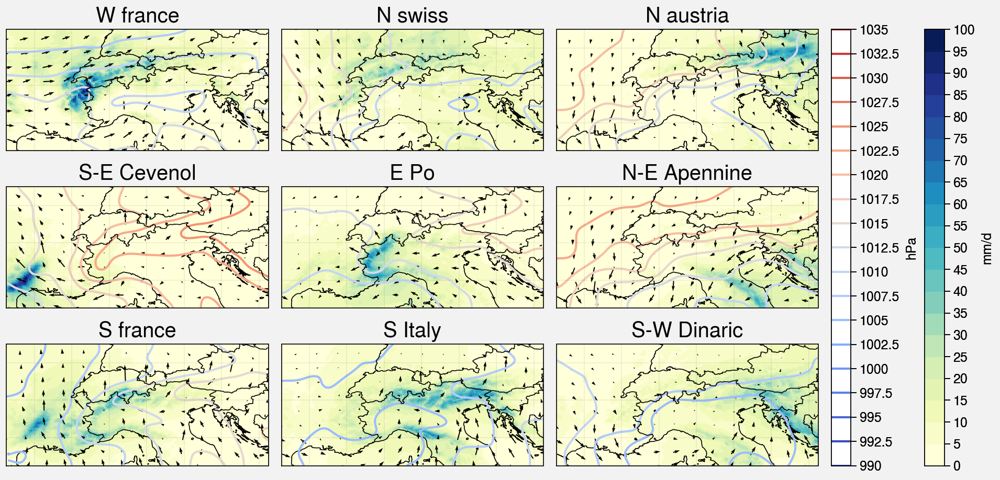

In [63]:
centroids,centroids_SLP,centroids_U,centroids_V = np.load('/home/philinat/Stage-M2/saved_clustering/centroids_data.npy')
f, axs = pplt.subplots(proj='cyl',ncols=3, nrows=3)
for i in range(9):
    cb_prec=axs[i].pcolormesh(lon_,lat_,centroids[i],levels=np.linspace(0,100,21),cmap='YlGnBu')
    axs[i].format(title=['W france','N swiss','N austria','S-E Cevenol','E Po','N-E Apennine','S france','S Italy','S-W Dinaric'][i] ,titlesize='20px')

    cb_SLP = axs[i].contour(lon_,lat_,gaussian_filter(centroids_SLP[i], 5),levels=np.linspace(990,1035,19),cmap='coolwarm')
    step=12
    axs[i].quiver(lon_[::step,::step],lat_[::step,::step],centroids_U[i,::step,::step],centroids_V[i,::step,::step],width=0.004,scale=250)

f.colorbar(cb_SLP,label= 'hPa')
f.colorbar(cb_prec,label= 'mm/d')
axs.format(**EUROCORDEX_format,suptitle='')

In [3]:
ds_rr = xr.open_mfdataset('/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.MBrr.*.nc')
ds_sf = xr.open_mfdataset('/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.MBsf.*.nc')
dates = ds_rr.MBrr.time
P = np.array(ds_rr.MBrr.data[:,jmin:jmax,imin:imax] + ds_sf.MBsf.data[:,jmin:jmax,imin:imax])
U = np.array(xr.open_mfdataset('/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.UUz.*.nc').UUz.data[:,3,jmin:jmax,imin:imax])
V = np.array(xr.open_mfdataset('/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.VVz.*.nc').VVz.data[:,3,jmin:jmax,imin:imax])

In [72]:
centroids_P,centroids_SLP,centroids_U,centroids_V = np.load('/home/philinat/Stage-M2/saved_clustering/centroids_data.npy')

classification = np.zeros(len(P),dtype=int)
for i in range(len(P)):
    if np.max(P[i]) < 5:
        classification[i] = 10
        continue
    min_dist = 1. ; k=0
    for j in range(9):
        dist = 0.
        dist += (1- np.sum(P[i]*centroids_P[j]) / np.sqrt(np.sum(P[i]**2)*np.sum(centroids_P[j]**2)))/2
        dist += (1- np.sum(U[i]*centroids_U[j]+V[i]*centroids_V[j]) / np.sqrt(np.sum(U[i]**2+V[i]**2)*np.sum(centroids_U[j]**2+centroids_V[j]**2)))/4
        if dist < min_dist:
            min_dist = dist ; k=j
    if min_dist < 0.5:
        classification[i] = k
    else:
        classification[i] = 9

In [77]:
freqs = np.array([np.mean(classification==i) for i in range(11)])

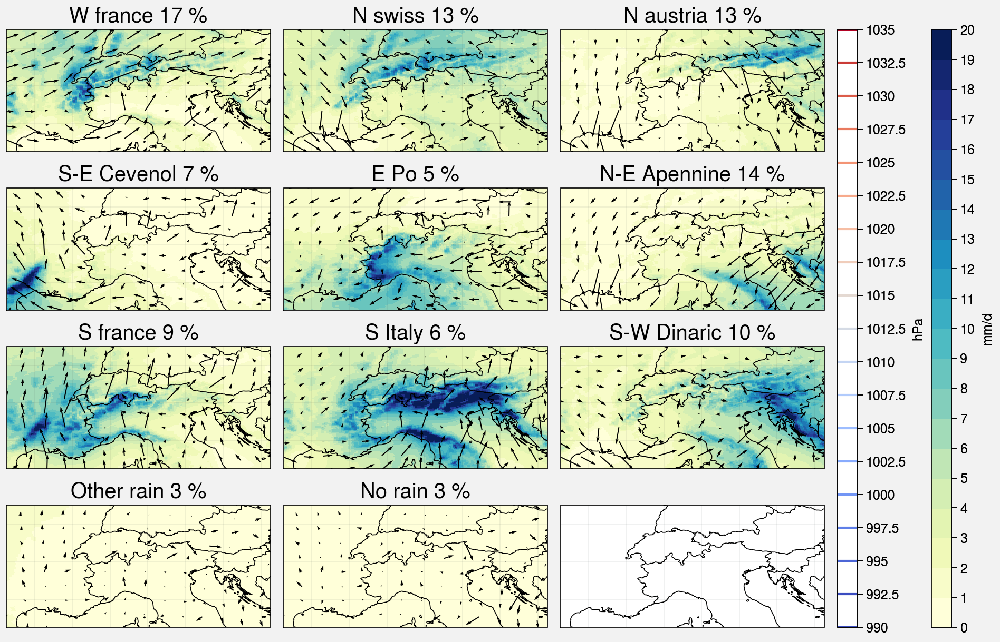

In [88]:
f, axs = pplt.subplots(proj='cyl',ncols=3, nrows=4)
for i in range(11):
    cb_prec=axs[i].pcolormesh(lon_,lat_,np.mean(P[classification==i],0),levels=np.linspace(0,20,21),cmap='YlGnBu')
    axs[i].format(title=['W France','N Swiss','N Austria','S-E Cevenol','E Po','N-E Apennine','S France','S Italy','S-W Dinaric','Other rain','No rain'][i]+' '+ str(round(100*freqs[i]))+' %' ,titlesize='20px')

    # cb_SLP = axs[i].contour(lon_,lat_,gaussian_filter(centroids_SLP[i], 5),levels=np.linspace(990,1035,19),cmap='coolwarm')
    step=12
    axs[i].quiver(lon_[::step,::step],lat_[::step,::step],np.mean(U[classification==i],0)[::step,::step],np.mean(V[classification==i],0)[::step,::step],width=0.004,scale=100)

f.colorbar(cb_SLP,label= 'hPa')
f.colorbar(cb_prec,label= 'mm/d')
axs.format(**EUROCORDEX_format,suptitle='')

In [98]:
freq_season = np.zeros((11,4))
for j,s in enumerate(['DJF','MAM','JJA','SON']):
    freq_season[:,j] = np.array([400*np.mean(np.logical_and(classification==i,dates.dt.season==s)) for i in range(11)])

In [99]:
freq_season

array([[23.4775641 , 15.30448718, 14.18269231, 13.67521368],
       [ 6.91773504, 12.36645299, 23.15705128,  7.66559829],
       [11.91239316, 13.91559829, 16.26602564,  9.80235043],
       [ 9.48183761,  5.71581197,  1.09508547, 11.19123932],
       [ 4.86111111,  6.00961538,  3.71260684,  6.86431624],
       [15.27777778, 13.43482906, 12.39316239, 15.27777778],
       [ 6.73076923,  9.82905983,  8.30662393,  9.88247863],
       [ 5.50213675,  6.91773504,  5.58226496,  7.8792735 ],
       [ 7.8525641 ,  8.78739316, 12.92735043, 11.35149573],
       [ 3.01816239,  3.1517094 ,  2.43055556,  3.31196581],
       [ 3.81944444,  5.31517094,  0.69444444,  2.75106838]])

In [97]:
print(np.sum(freq_season,0))

[0.98851496 1.00747863 1.00747863 0.99652778]


In [24]:
from windrose import WindroseAxes
import matplotlib.cm as cm
def plot_monthrose(fig,rect,event_months,event_maxs,title="",max_plot_rain = 300):
    axe = WindroseAxes.from_ax(fig=fig,rect=rect)
    axe.bar(event_months, event_maxs,normed=True,nsector=12,opening=0.9, bins=np.linspace(150,max_plot_rain,21),cmap= cm.YlGnBu)
    axe.set_title(title,y=1.05)
    axe.set_yticklabels([])
    axe.set_rgrids([],angle=0)
    axe.set_thetagrids(range(0,360,30),labels=('J','F','M','A','M','J','J','A','S','O','N','D'))
    axe.tick_params(pad=-20)

In [27]:
ncols = 3 ; nrows=3
fig = plt.figure(figsize=(15,5))
for i in range(min(ncols*nrows,len(centroids))):
    c = clusters[int(np.argwhere(sort==i))]
    # rect = [i/len(clusters),0,1/len(clusters),1]
    rect = [i%ncols/ncols,1-1/nrows-i//ncols/nrows,1/ncols,1/nrows]
    plot_monthrose(fig,rect,((event_months[c]-1)/12*360)%360,event_maxs[c],title=str(len(c)))

/home/philinat/miniconda3/envs/erca/lib/python3.8/site-packages/windrose/windrose.py:781: RuntimeWarning: invalid value encountered in true_divide
  table = table * 100 / table.sum()
/home/philinat/miniconda3/envs/erca/lib/python3.8/site-packages/windrose/windrose.py:147: RuntimeWarning: invalid value encountered in double_scalars
  if rmax % N == 0:


ValueError: cannot convert float NaN to integer

<Figure size 1500x500 with 9 Axes>

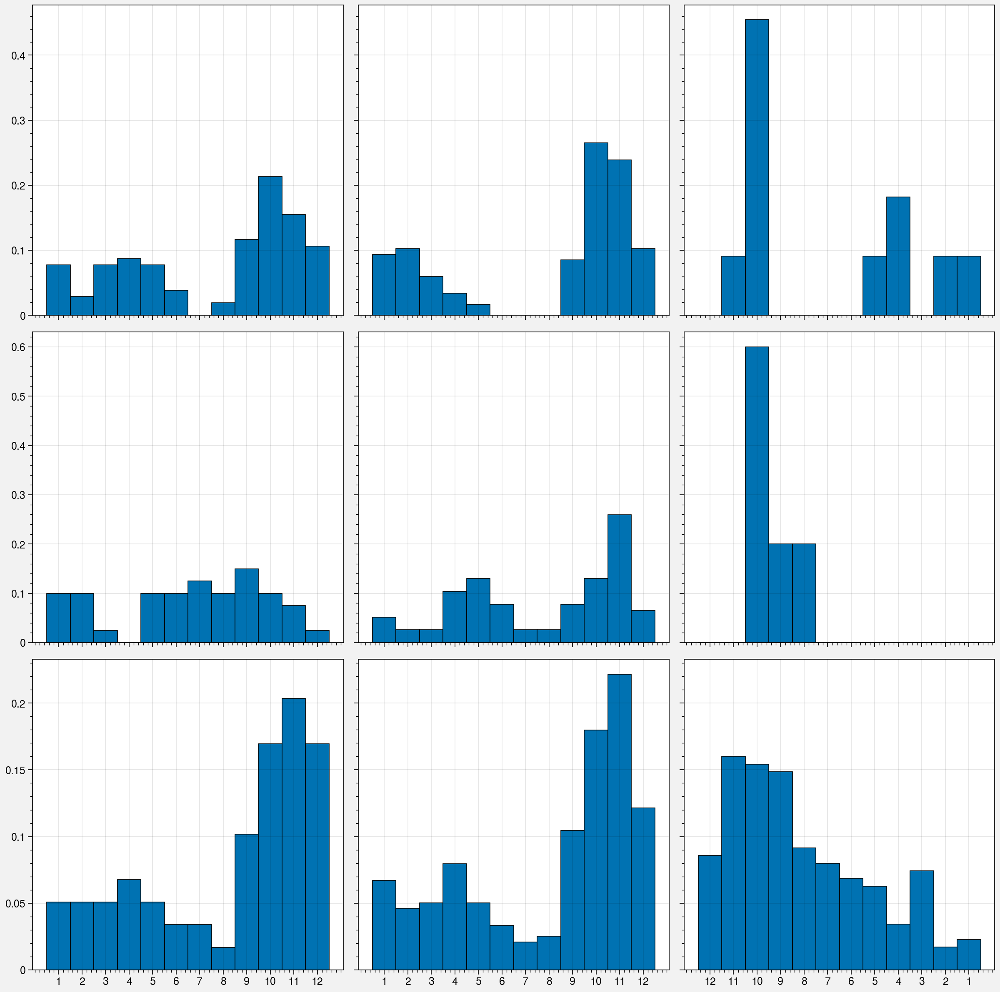

In [32]:
f, axs = pplt.subplots(ncols=ncols, nrows=nrows,width=12)
for i in range(min(ncols*nrows,len(centroids))):
    c = clusters[int(np.argwhere(sort==i))]
    axs[i].hist(event_months[c],bins=range(1,14),align='left',density=True)
    axs[i].set_xticks(range(1,13))#,labels=('J','F','M','A','M','J','J','A','S','O','N','D'))

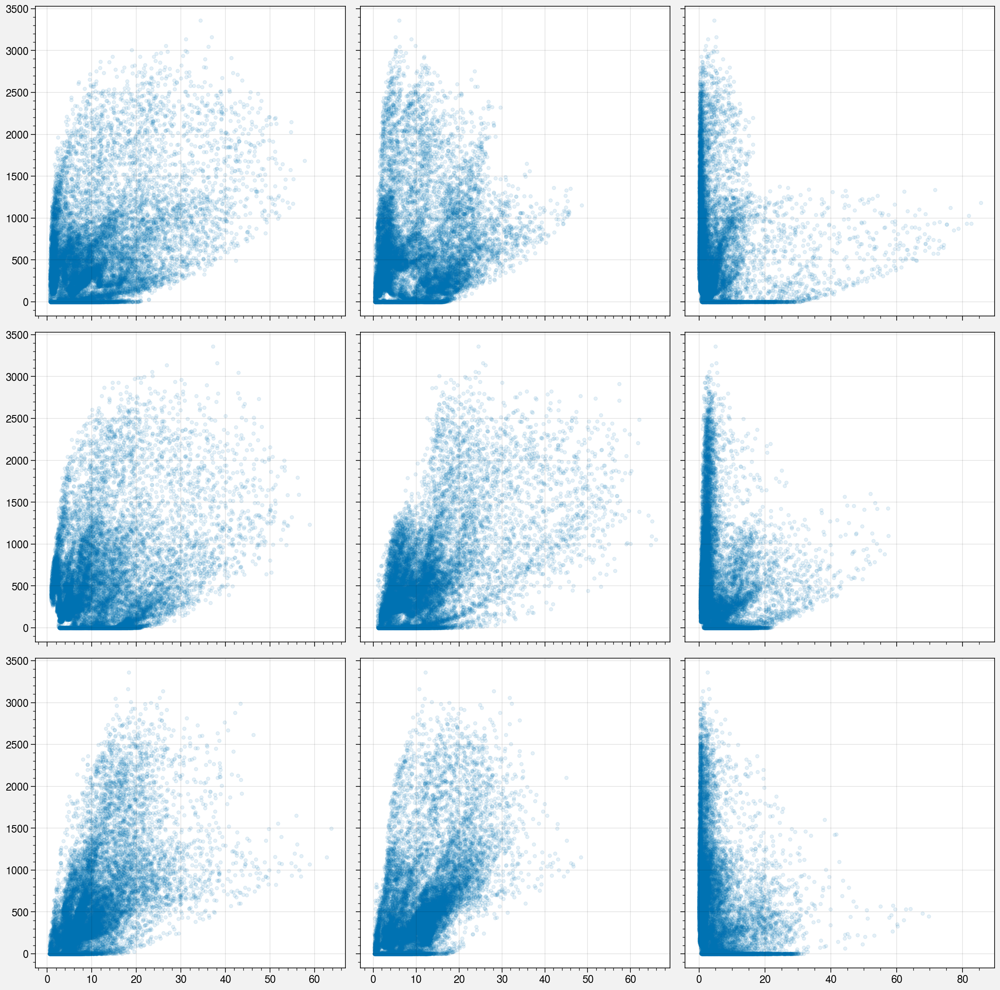

In [34]:
ncol,nrows=3,3
f, axs = pplt.subplots(ncols=ncol, nrows=nrows,width=12)
for i in range(min(ncols*nrows,len(centroids))):
    h = np.ndarray.flatten(H_,order='F' )
    p = np.ndarray.flatten(centroids[i],order='F')
    axs[i].scatter( p, h ,marker='.',alpha=0.1)

In [46]:
ntime ,nlat ,nlon= np.shape(events)
z = np.reshape(events,(ntime,nlat*nlon))
zmean = np.mean(z,axis=0)
z-=zmean
mat_cov = np.matmul(np.transpose(np.matrix(z)),np.matrix(z))/ntime
print("Matrice calculée :",np.shape(mat_cov))

# w = np.linalg.eigvalsh(mat_cov)
# w = -np.sort(-w)
# print("Valeurs propres calculées :",np.shape(mat_cov))
wsort , vsort = scipy.sparse.linalg.eigs(mat_cov,8)
wsort = np.real(wsort)
vsort = np.real(vsort) + zmean.reshape(nlat*nlon,1)
print("Vecteurs propres calculés :",np.shape(wsort),np.shape(vsort))



Matrice calculée : (9044, 9044)
Vecteurs propres calculés : (8,) (9044, 8)


Text(0.5, 1.0, 'Zoom sur les 20 premières')

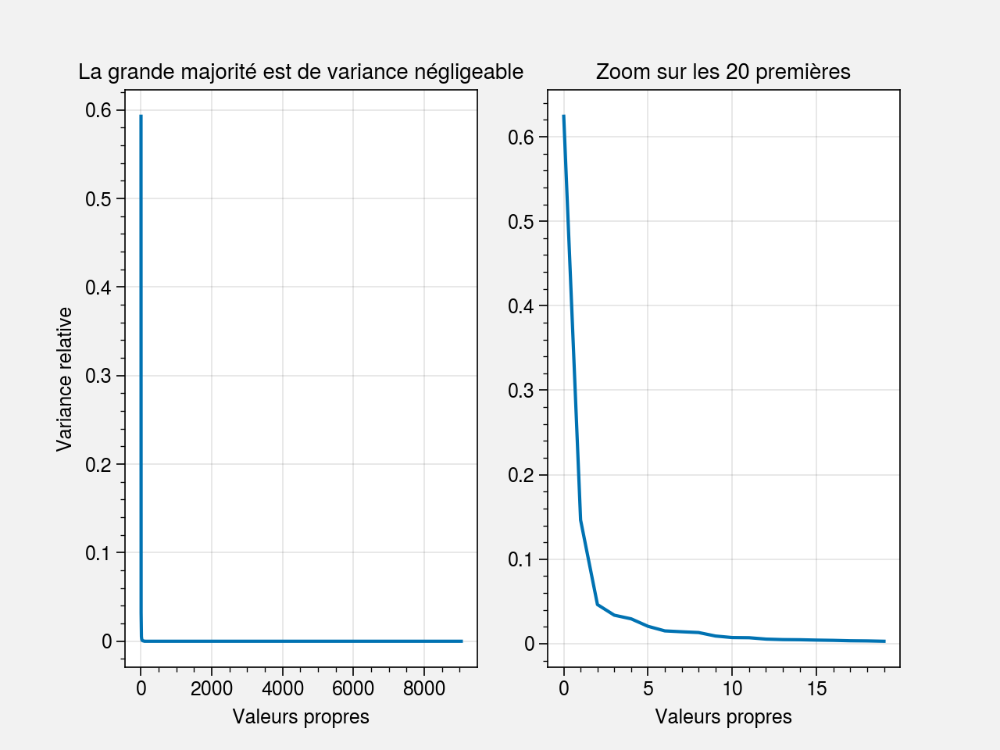

In [39]:
fig,axes = plt.subplots(ncols=2)
axes[0].plot(w/np.sum(w))
axes[0].set_ylabel("Variance relative")
axes[0].set_xlabel("Valeurs propres")
axes[0].set_title("La grande majorité est de variance négligeable")
axes[1].plot(w[:20]/np.sum(w[:20]))
axes[1].set_xlabel("Valeurs propres")
axes[1].set_title("Zoom sur les 20 premières")

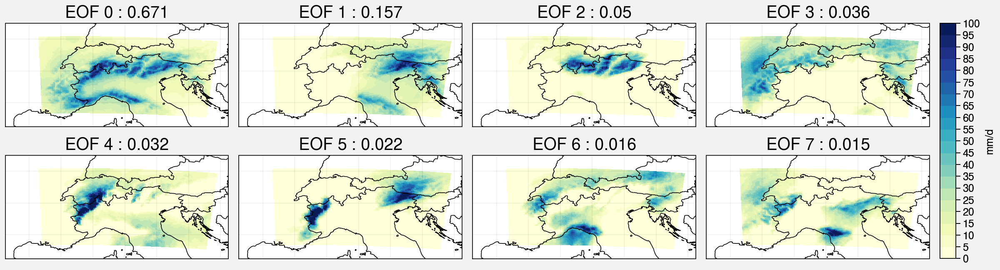

In [44]:
f, axs = pplt.subplots(proj='cyl',ncols=4, nrows=2,width=12)
for i in range(8):
    cb_prec=axs[i].pcolormesh(lon_,lat_,np.reshape(vsort[:,i]*3000,(nlat,nlon)),levels=np.linspace(0,100,21),cmap='YlGnBu')
    axs[i].format(title='EOF '+str(i)+' : '+str(np.around(wsort[i]/np.sum(wsort),3)),titlesize='20px')
f.colorbar(cb_prec,label= 'mm/d')
axs.format(**EUROCORDEX_format)
#np.sqrt(wsort[i])

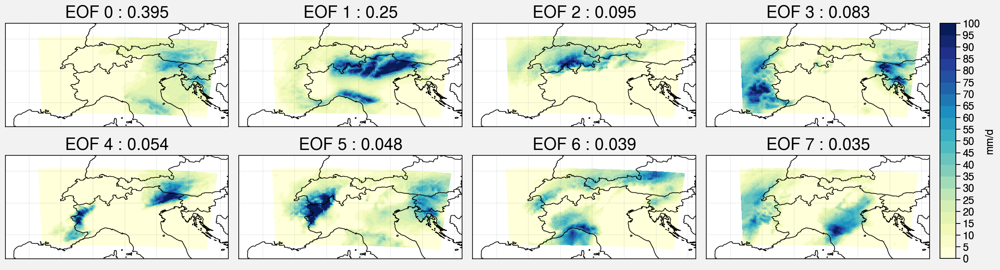

In [47]:
f, axs = pplt.subplots(proj='cyl',ncols=4, nrows=2,width=12)
for i in range(8):
    cb_prec=axs[i].pcolormesh(lon_,lat_,np.reshape(vsort[:,i]*3000,(nlat,nlon)),levels=np.linspace(0,100,21),cmap='YlGnBu')
    axs[i].format(title='EOF '+str(i)+' : '+str(np.around(wsort[i]/np.sum(wsort),3)),titlesize='20px')
f.colorbar(cb_prec,label= 'mm/d')
axs.format(**EUROCORDEX_format)
#np.sqrt(wsort[i])

(array([  38.,   86.,  150.,  369.,  690., 1657., 1833., 3186.,  889.,
         146.]),
 array([-0.04552438, -0.03865572, -0.03178706, -0.0249184 , -0.01804974,
        -0.01118108, -0.00431242,  0.00255624,  0.0094249 ,  0.01629356,
         0.02316223], dtype=float32),
 <a list of 10 Patch objects>)

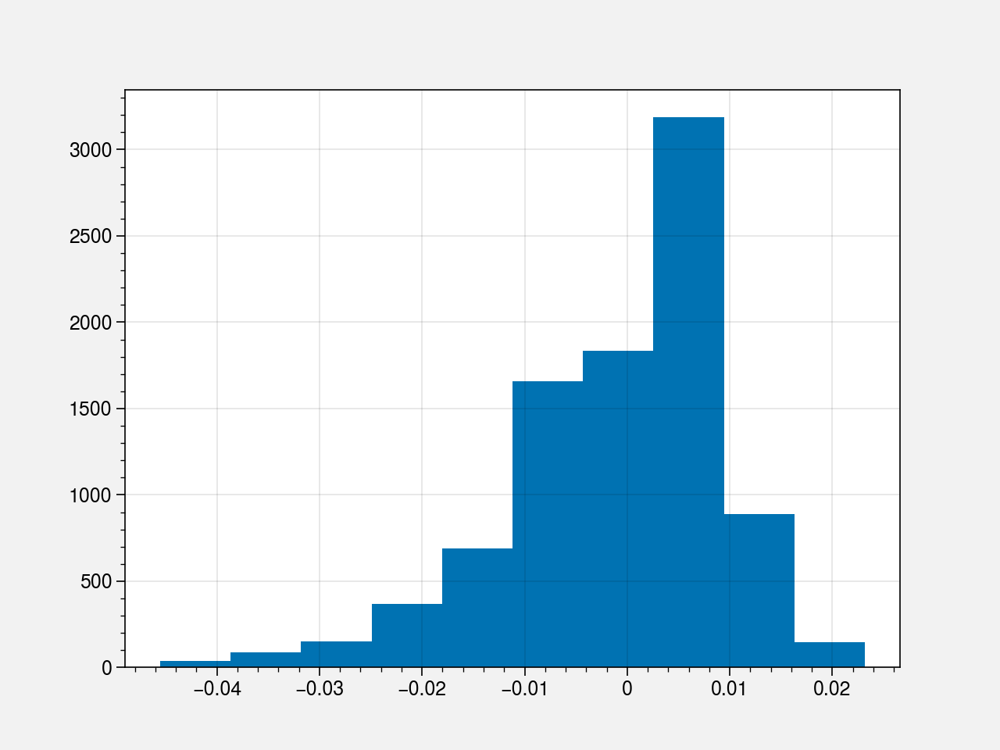

In [48]:
plt.hist(vsort[:,0])

In [34]:
np.sqrt(w[:])

/tmp/ipykernel_69740/526402247.py:1: RuntimeWarning: invalid value encountered in sqrt
  np.sqrt(w[:])


array([2339.7114 , 1133.2797 ,  637.42065, ...,        nan,        nan,
              nan], dtype=float32)

In [36]:
wsort

array([5474250.5 +0.j, 1284322.1 +0.j,  406304.94+0.j,  295981.28+0.j,
        258268.47+0.j,  180729.44+0.j,  133110.75+0.j,  124167.2 +0.j],
      dtype=complex64)

In [35]:
np.sum(w)

9234451.0

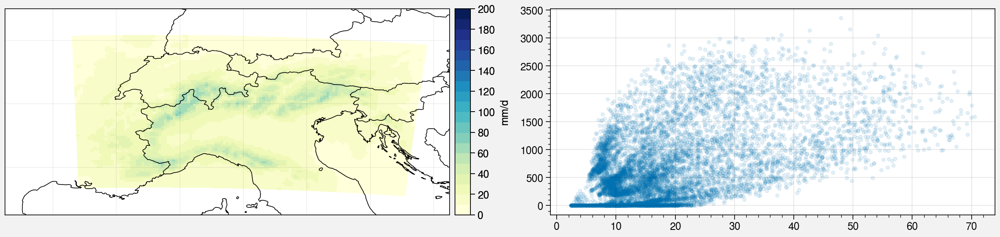

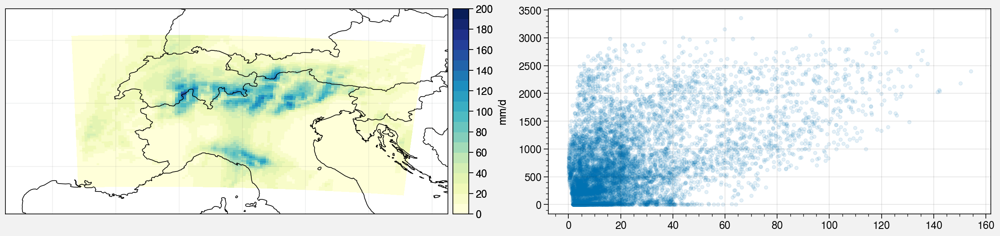

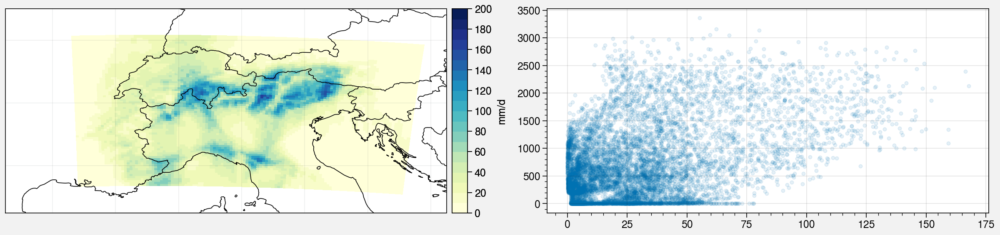

In [61]:
for event in [np.mean(events,0),events[2],events[20]]:
    f, axs = pplt.subplots(proj=('cyl',None),ncols=2, nrows=1,width=12)
    colors = ['#1f77b4','#bcbd22', '#2ca02c', '#d62728', '#9467bd',  '#ff7f0e', '#17becf']
     for region in range(5):
        if region==0:
            i1 = 50 ; i2 = 58 ; j1 = 73 ; j2 = 87 # jura
            # i1 = 100 ; i2 = 120 ; j1 = 35 ; j2 = 45 # appenins
        if region==1:
            i1 = 72 ; i2 = 82 ; j1 = 73 ; j2 = 88 # suisse
        if region==2:
            i1 = 58 ; i2 = 67 ; j1 = 62 ; j2 = 73 # savoie
        if region==3:
            i1 = 70 ; i2 = 78 ; j1 = 62 ; j2 = 72 # mont rose
        if region==4:
            i1 = 145 ; i2 = 160 ; j1 = 45 ; j2 = 63 # croatie
        if region==5:
            i1 = 123 ; i2 = 137 ; j1 = 84 ; j2 = 90 # grossglokner
            # i1 = 100 ; i2 = 130 ; j1 = 82 ; j2 = 92 # tirol
            # i1 = 105 ; i2 = 120 ; j1 = 65 ; j2 = 80 # sud tirol


        axs[0].plot( [ lon_[j1,i1],lon_[j1,i2],lon_[j2,i2],lon_[j2,i1],lon_[j1,i1] ],
                  [ lat_[j1,i1],lat_[j1,i2],lat_[j2,i2],lat_[j2,i1],lat_[j1,i1] ] , '--',color=colors[region],linewidth=2)

        
        h = np.ndarray.flatten(H_[j1:j2,i1:i2],order='F' )
        p = np.ndarray.flatten(event[j1:j2,i1:i2],order='F')
        axs[1].scatter( p, h ,marker='.',alpha=0.5,color=colors[region])
        
        m, b = np.polyfit(p, h, 1)
        x= np.linspace(np.min(p),np.max(p),2)
        axs[1].plot(x, m*x + b,color=colors[region])
        
        
    cb_prec=axs[0].pcolormesh(lon_,lat_,event,levels=np.linspace(0,200,21),cmap='YlGnBu')
    f.colorbar(cb_prec,ax=axs[0],label= 'mm/d')
    axs[0].format(**EUROCORDEX_format)

    

array([[8.065919 , 8.072033 , 8.380567 , ..., 2.393426 , 2.42147  ,
        2.435244 ],
       [8.076999 , 8.026592 , 8.092083 , ..., 2.5050087, 2.532919 ,
        2.5782816],
       [8.247306 , 8.059185 , 8.112965 , ..., 2.7079325, 2.6622863,
        2.7646964],
       ...,
       [5.5737867, 6.0299206, 6.323525 , ..., 7.6679897, 7.2661505,
        7.53197  ],
       [5.723241 , 5.8473372, 6.0134563, ..., 7.7247577, 8.137697 ,
        7.9993067],
       [5.86624  , 5.8942018, 5.9383063, ..., 6.975845 , 7.2621264,
        6.939217 ]], dtype=float32)

In [100]:
from numba import njit
from numba.typed import List

@njit
def foo(x):
    x.append(10)

a = [1, 2, 3]
typed_a = List()
[typed_a.append(x) for x in a]
foo(typed_a)